# Cleaning

## Removing time and putting the words into a single text file.

In [67]:
import os
import re

folder_path = "Dataset"

timestamp_pattern = re.compile(r'\b\d{1,2}:\d{2}(:\d{2})?\b')

for root, dirs, files in os.walk(folder_path):
    if "cleaned" in root.split(os.sep):
        continue

    for filename in files:
        if filename.endswith(".txt"):
            file_path = os.path.join(root, filename)
            with open(file_path, 'r', encoding='utf-8') as file:
                text = file.read()

            cleaned_text = re.sub(timestamp_pattern, '', text)  
            cleaned_text = ' '.join(cleaned_text.split()) 

            save_path = os.path.join(os.path.dirname(root), "cleaned")
            os.makedirs(save_path, exist_ok=True)

            with open(os.path.join(save_path, filename), 'w', encoding='utf-8') as file:
                file.write(cleaned_text)


---
# Preproccessing

## Tokenization

In [68]:
import nltk
from nltk.tokenize import *

folder_path = "Dataset"
data = {}

for root, dirs, files in os.walk(folder_path):
    if "raw_transcripts" in root.split(os.sep):
        continue
    for filename in files:
        if filename.endswith(".txt"):
            file_path = os.path.join(root, filename)
            with open(file_path, 'r', encoding='utf-8') as file:
                text = file.read()
                tokens = nltk.tokenize.wordpunct_tokenize(text)
                data[filename] = {
                    "tokens": [],
                    "stemming": [],
                    "lemmatization": [],
                    "filteredTokens": []
                }
                data[filename]["tokens"].extend(tokens)

## Stemming

In [69]:
from nltk.stem.isri import ISRIStemmer 
isri = ISRIStemmer()


for filename in data:
    stemmas=[]
    for token in data[filename]["tokens"]:
        stemmas.append(isri.stem(token)) 
    data[filename]["stemming"].extend(stemmas)

## Lemmatization

## Stop Word filtering

In [70]:
import nltk
from nltk.corpus import stopwords
nltk.download("stopwords")
arabic_stopwords = set(stopwords.words("arabic"))
for filename in data:
    filtered_tokens = [word for word in data[filename]["tokens"] if word not in arabic_stopwords]
    data[filename]["filteredTokens"].extend(filtered_tokens)

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\asus\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


---
# Analysis

C:\Users\asus\AppData\Local\Temp\ipykernel_18860\1914730663.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 5))


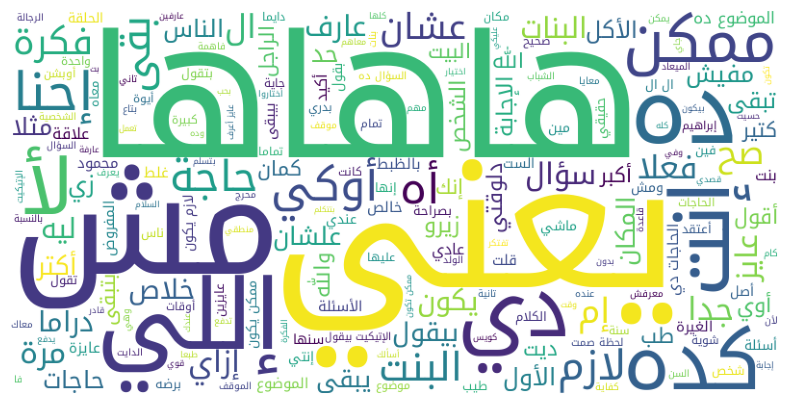

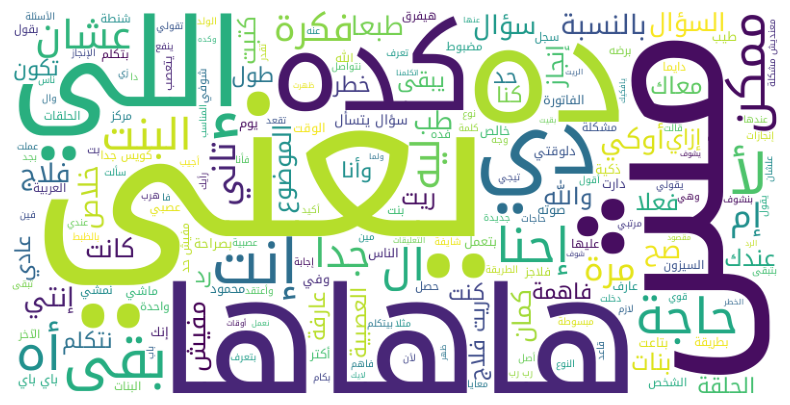

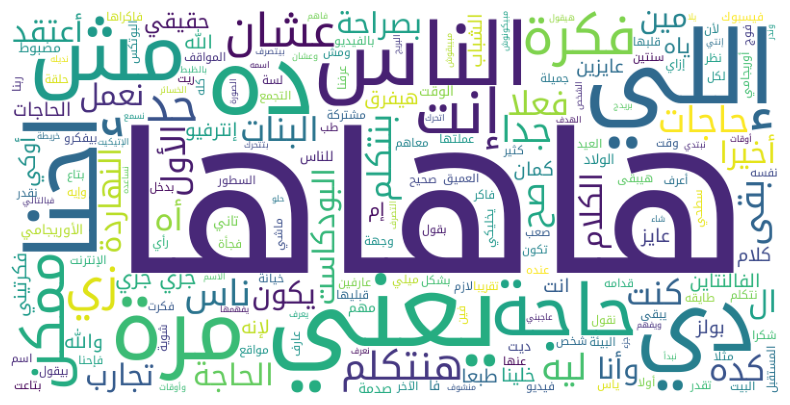

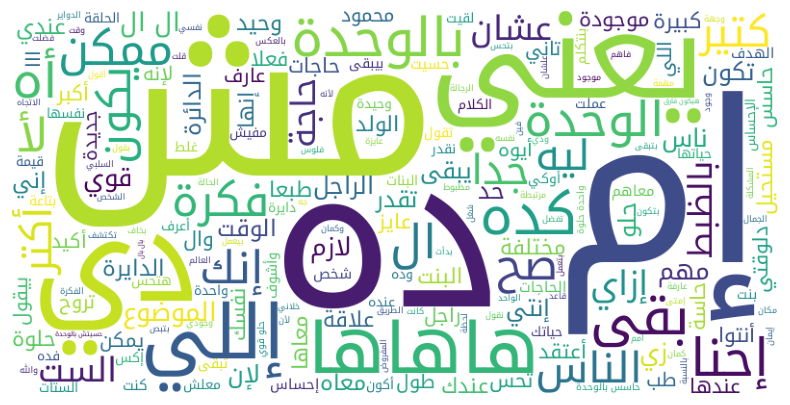

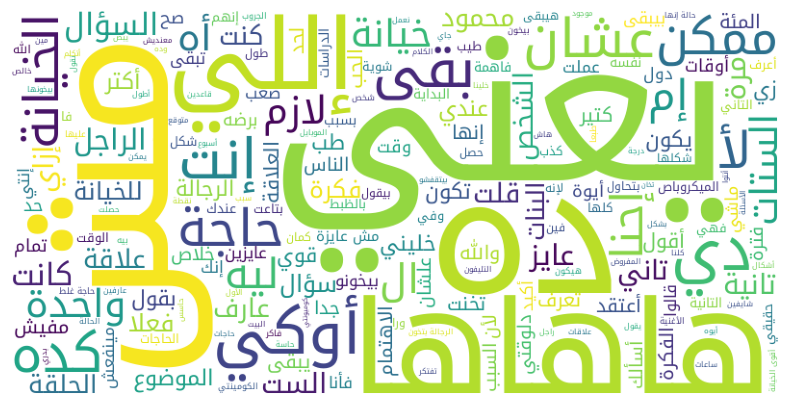

...

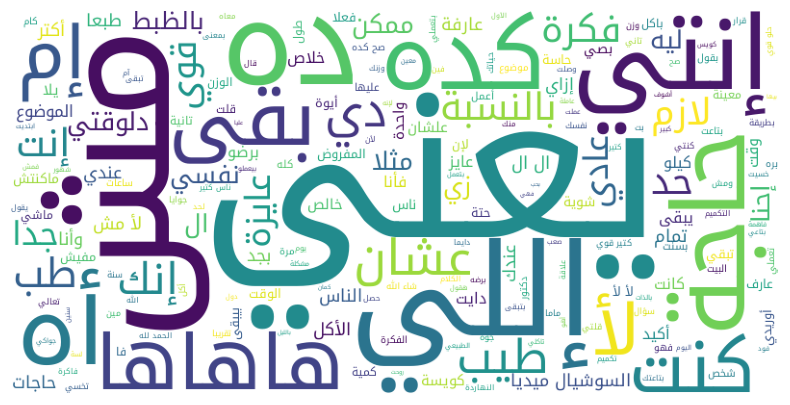

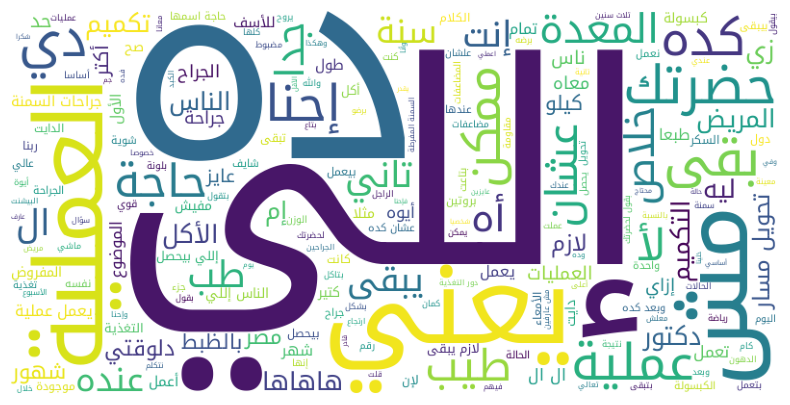

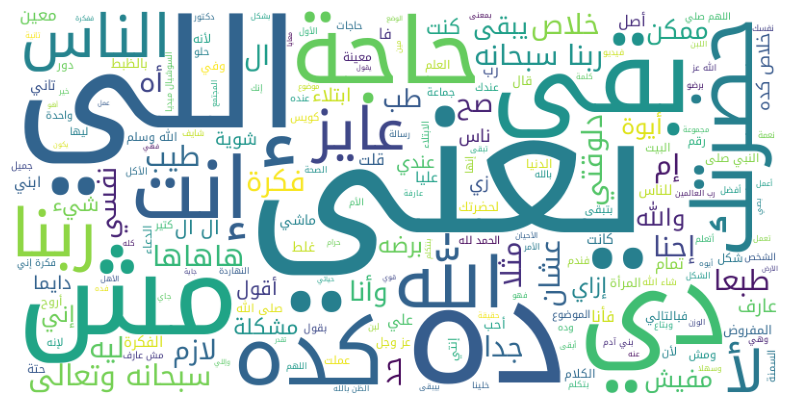

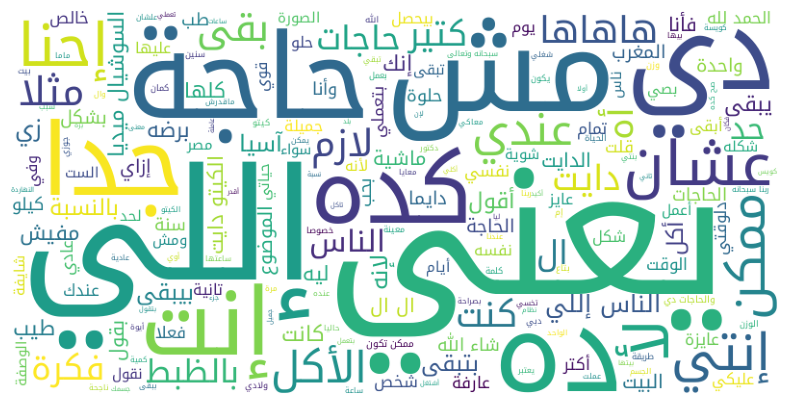

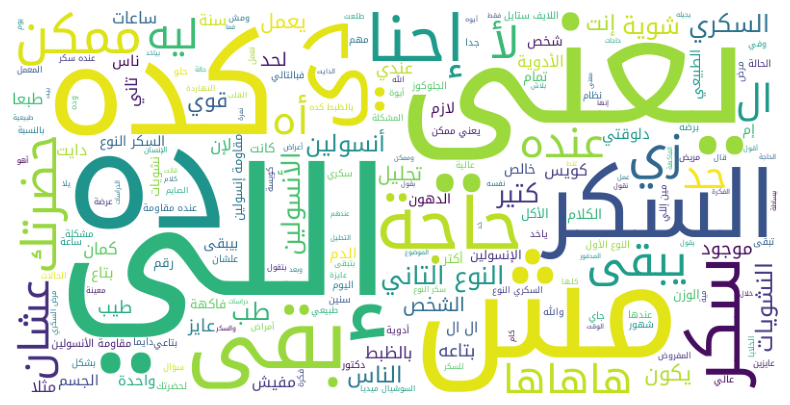

In [71]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import arabic_reshaper
from bidi.algorithm import get_display

font_path = "NotoKufiArabic-VariableFont_wght.ttf"

for filename in data:
    
    reshaped_text = arabic_reshaper.reshape(" ".join(data[filename]["filteredTokens"]))
    bidi_text = get_display(reshaped_text)

    wordcloud = WordCloud(
        width=800, height=400, font_path=font_path, background_color='white'
    ).generate(bidi_text)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.savefig(f"wordcloud_{filename}.png")
